 ## Assignment 3- Edge detection 


Tasks:

- Draw a green rectangular box to show a region of interest (ROI) around the main body of text in the middle of the image. Save this as image_with_ROI.jpg.
- Crop the original image to create a new image containing only the ROI in the rectangle. Save this as image_cropped.jpg.
- Using this cropped image, use Canny edge detection to 'find' every letter in the image
- Draw a green contour around each letter in the cropped image. Save this as image_letters.jpg




In [ ]:
#importing  

import os
import sys
sys.path.append(os.path.join(".."))
import cv2
import numpy as np
import glob
import matplotlib as mpl
import matplotlib.pyplot as plt
from pathlib import Path
import csv

In [12]:
def jimshow(image, title=False):
    """imshow with matplotlib dependencies 
    """
    # Acquire default dots per inch value of matplotlib
    dpi = mpl.rcParams['figure.dpi']

    height, width, depth = image.shape
    figsize = width / float(dpi), height / float(dpi)
    
    plt.figure(figsize=figsize)
    
    if depth == 1:
        plt.imshow(image, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
      
    if title:
        plt.title(title)
    plt.axis('off')
    
    plt.show()
    

def jimshow_channel(image, title=False):
    """
    Modified jimshow() to plot individual channels
    """
    # Acquire default dots per inch value of matplotlib
    dpi = mpl.rcParams['figure.dpi']

    height, width = image.shape
    figsize = width / float(dpi), height / float(dpi)
    
    plt.figure(figsize=figsize)
    
    plt.imshow(image, cmap='gray')
      
    if title:
        plt.title(title)
    plt.axis('off')
    
    plt.show()


In [105]:
# loading the image 

file_path= os.path.join ("images/image.jpeg")

In [106]:
image= cv2.imread(file_path)

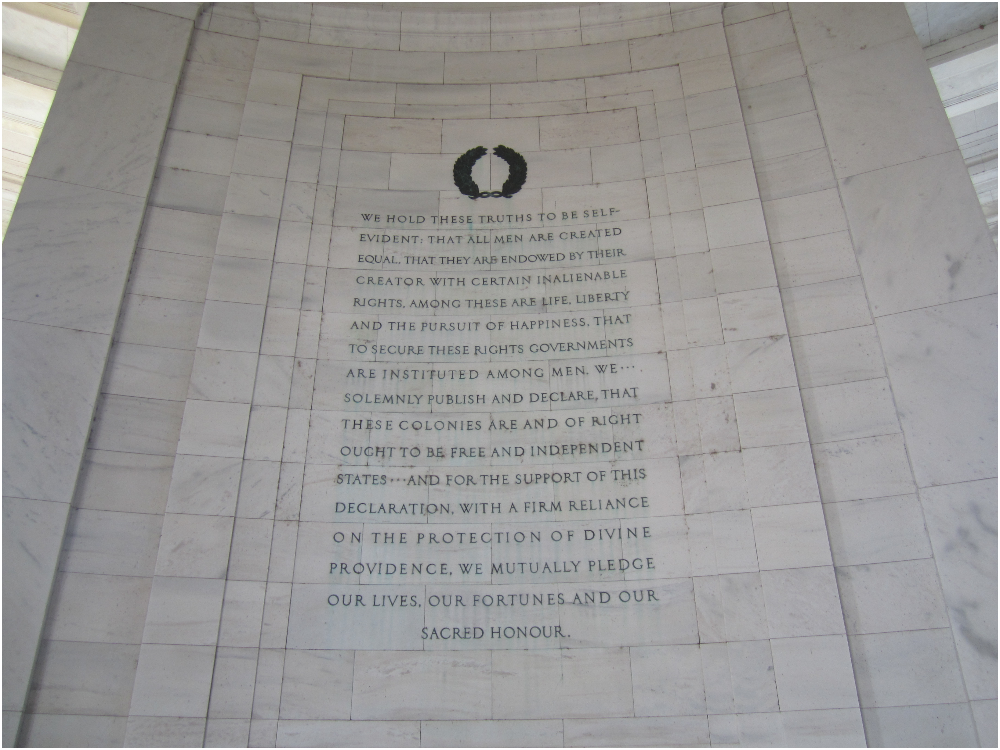

In [19]:
jimshow(image)

In [22]:
#inspecting the width and height of the picture
image.shape

(3240, 4320, 3)

__2. Drawing a rectangle containing AOI with text__

In [107]:
#specifying the area of interest (ROI)

upper_left =(1385,880) # specyfying corners of the picture 
bottom_right =(2890,2800) 
color = (0, 255, 0)
thickness = 4
#image_rectangle = cv2.rectangle(image.copy(), start_point, end_point, color, thickness)


image_ROI=cv2.rectangle(image.copy(), upper_left, bottom_right, color, thickness)

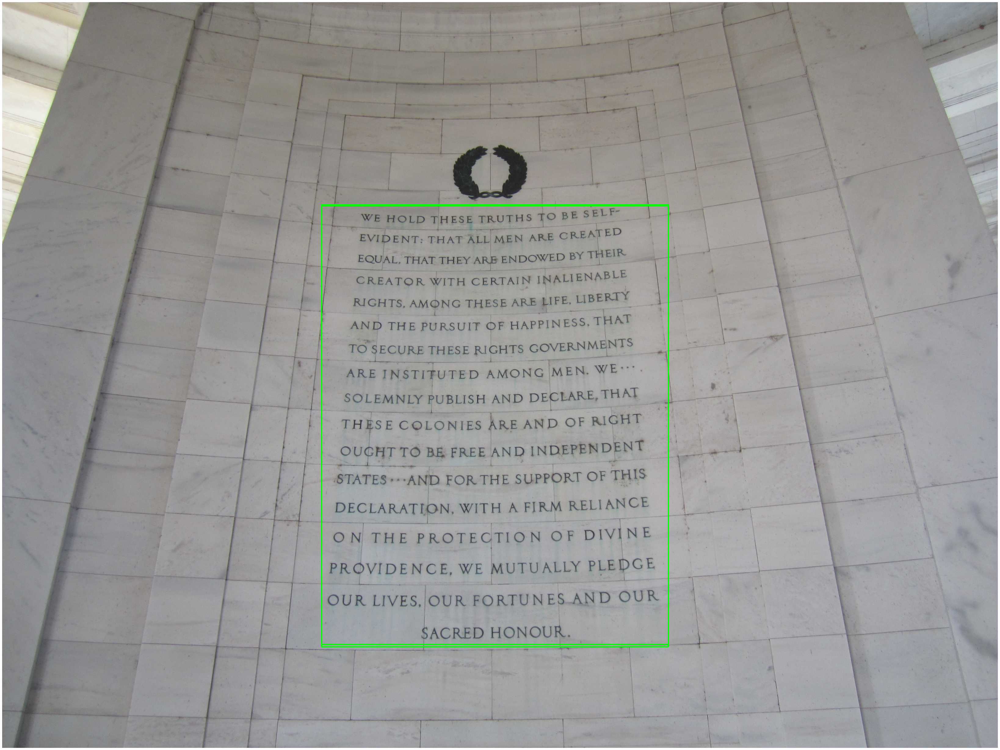

In [100]:
jimshow(image_ROI)

In [101]:
#saving the image in the 'images' folder

filename="images/image_with_ROI.jpg"
cv2.imwrite(filename,image_ROI)

True

__2. Cropping the image so that it only contains the AOI with text__

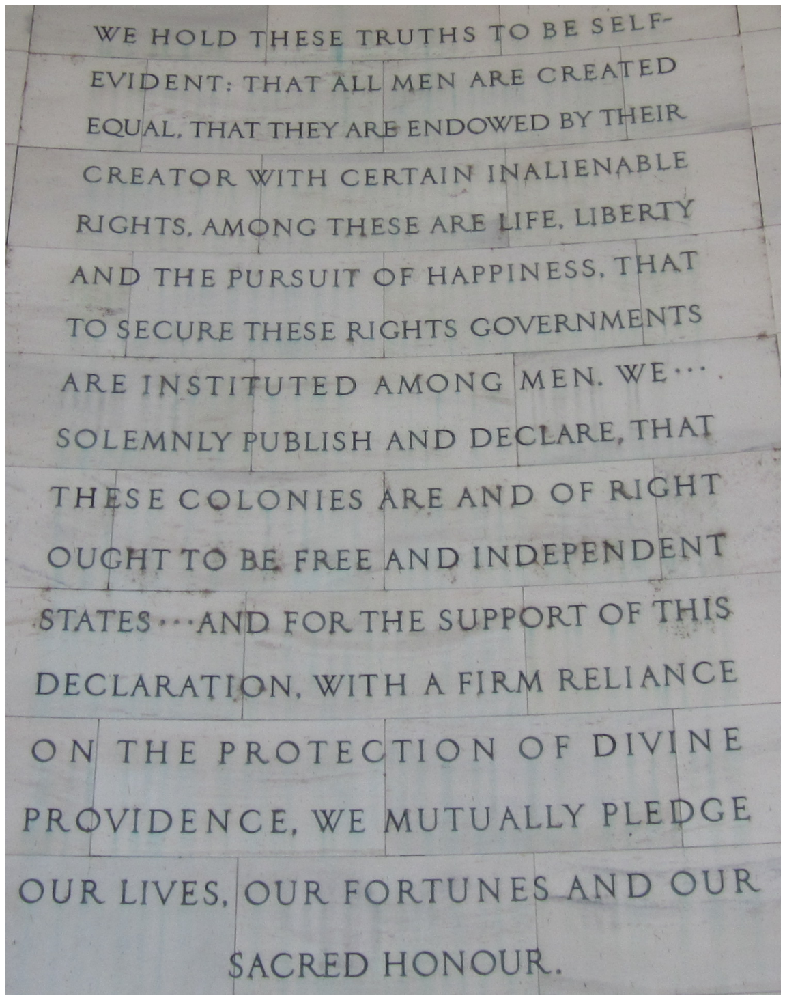

In [108]:
#cropping 

image_cropped = image[upper_left[1]:bottom_right[1],upper_left[0]:bottom_right[0]]
jimshow(image_cropped)

In [103]:
#saving the new image

filename2="images/image_cropped.jpg"
cv2.imwrite(filename2,image_cropped)


True

__3. Using cropped image, use Canny edge detection to 'find' every letter in the image__

In [83]:
#changing image to grey 
grey_image = cv2.cvtColor(image_cropped,cv2.COLOR_BGR2GRAY)


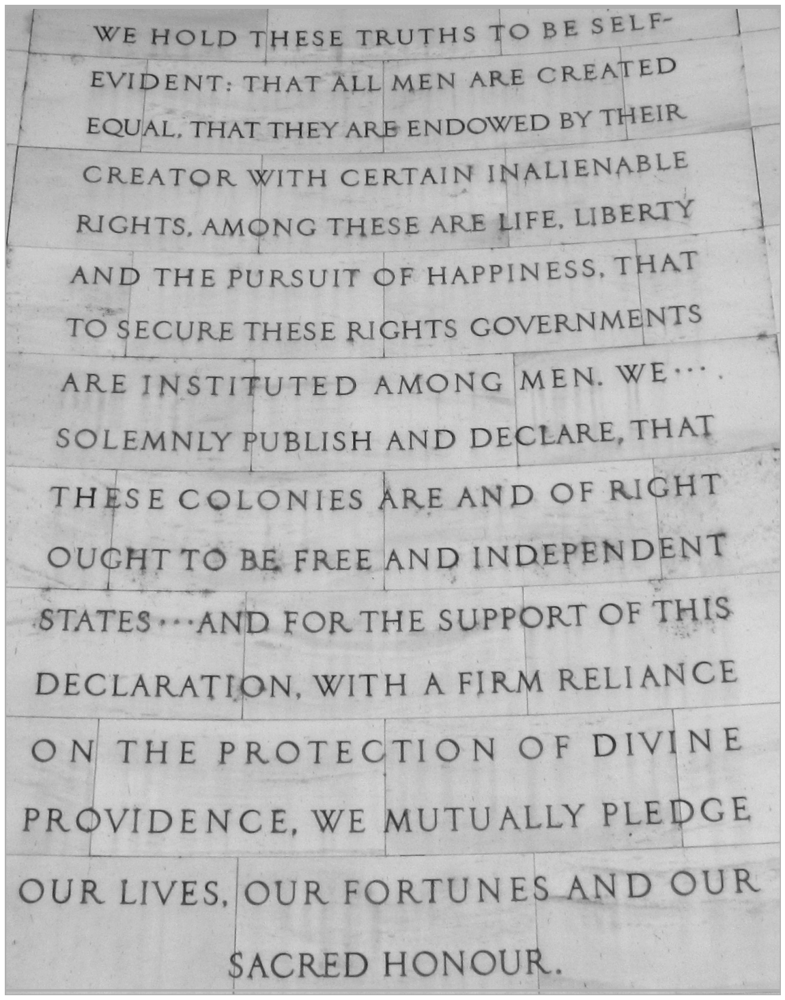

In [85]:
jimshow_channel(grey_image)

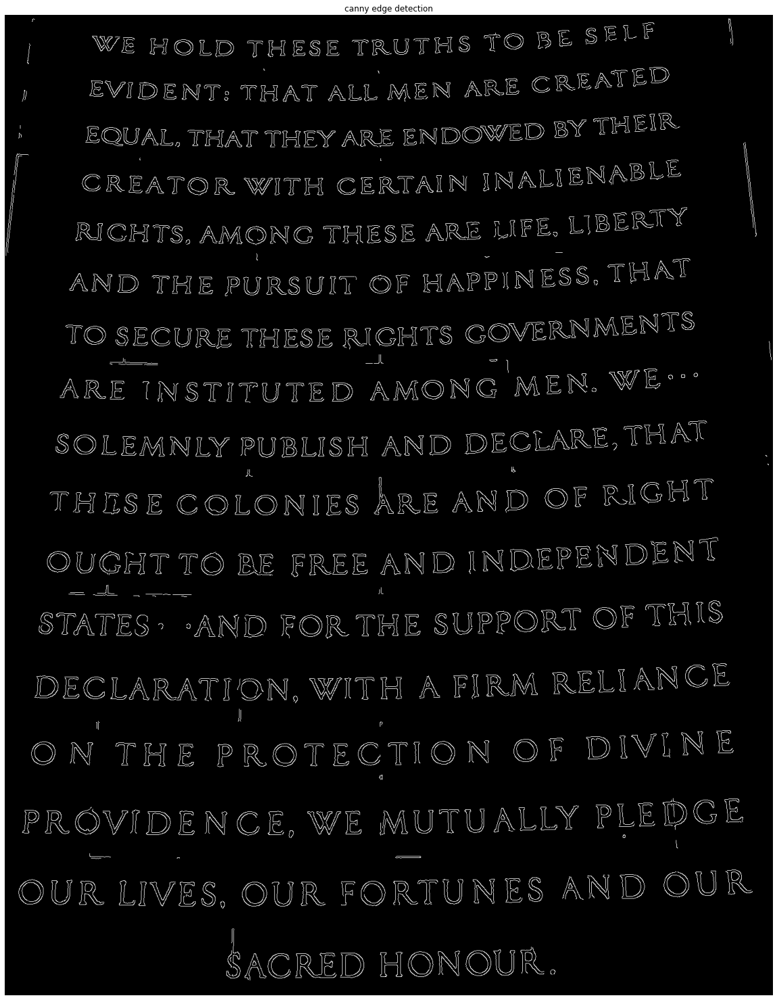

In [90]:
# we need to blur it first 
blurred= cv2.GaussianBlur(grey_image,(5,5),0)

#applying canny to the blurred image 
canny = cv2.Canny(blurred, 100,150)

#displaying 
jimshow_channel(canny,"canny edge detection")

__Drawing green contours around each letter in the cropped image.__

In [95]:
(contours,_) = cv2.findContours(canny.copy(),
                 cv2.RETR_EXTERNAL, #if there is an unbroken outline withing anoother contour it is ignored and only the outline that is hierarchicaly highest is taken into account 
                 cv2.CHAIN_APPROX_SIMPLE)

In [110]:
letters= cv2.drawContours(image_cropped.copy(), # draw contours on original image
                        contours,      # our list contours
                        -1,            # which contours to draw
                        (220,255,0),     # contour colour 
                        2)           # contour pixel width 
        

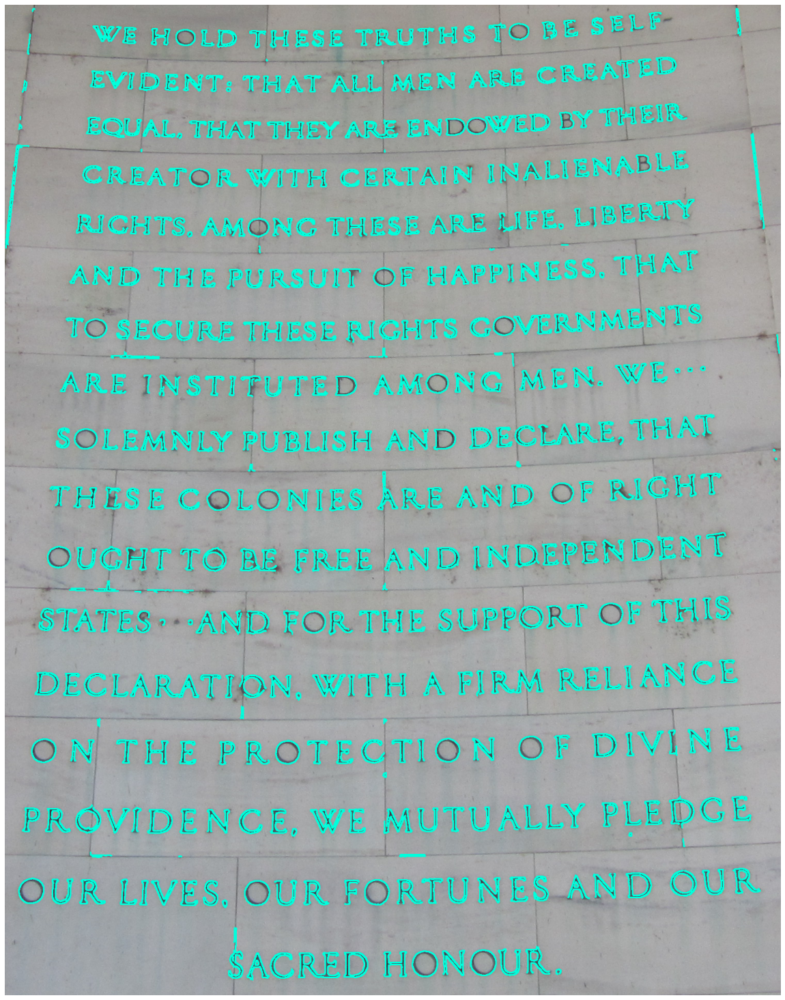

In [111]:
jimshow(letters)

In [112]:
#saving the image 

filename3="images/image_letters.jpg"
cv2.imwrite(filename3,letters)


True